In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import talib

Load Dataset

In [2]:
# df = pd.read_csv(r"C:\SierraCharts\Data\NDXT.txt")
df = pd.read_csv("../Dataset/process data/nasdaq_dataset.csv")
df.columns = [i.strip() for i in df.columns]        # remove extra spaces from columns names
df.rename(columns={'Last':'Close'}, inplace = True) # rename one of column
df.head()

,Date,Time,Open,High,Low,Close,Volume,NumberOfTrades,BidVolume,AskVolume,...,AROON_UP,ADX,STOCH_K,STOCH_D,MACD,MACD_SIGNAL,HAMMER,INVERTED_HAMMER,ENGULFING,Target
0,2011/6/13,20:00:00,1350.54,1350.54,1350.54,1350.54,0,0,0,0,...,21.428571,43.819322,40.615298,45.541867,-7.932664,-8.560322,0,0,0,0
1,2011/6/14,12:00:00,1363.16,1370.18,1363.16,1368.53,0,0,0,0,...,100.000000,42.298061,58.060659,48.180735,-6.232078,-8.094673,0,0,0,0
2,2011/6/14,13:00:00,1368.51,1374.46,1368.06,1373.62,0,0,0,0,...,100.000000,41.340922,76.586371,58.420776,-4.422650,-7.360269,0,0,0,0
3,2011/6/14,14:00:00,1373.62,1374.23,1370.97,1372.80,0,0,0,0,...,92.857143,40.452150,93.929978,76.192336,-3.020020,-6.492219,0,0,0,0
4,2011/6/14,15:00:00,1372.79,1373.59,1371.59,1372.15,0,0,0,0,...,85.714286,39.626862,93.361517,87.959288,-1.938528,-5.581481,0,0,0,0


## EDA

Dataset information

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24519 entries, 0 to 24518
Data columns (total 24 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Date             24519 non-null  object 
 1   Time             24519 non-null  object 
 2   Open             24519 non-null  float64
 3   High             24519 non-null  float64
 4   Low              24519 non-null  float64
 5   Close            24519 non-null  float64
 6   Volume           24519 non-null  int64  
 7   NumberOfTrades   24519 non-null  int64  
 8   BidVolume        24519 non-null  int64  
 9   AskVolume        24519 non-null  int64  
 10  ATR              24519 non-null  float64
 11  RSI              24519 non-null  float64
 12  AD               24519 non-null  float64
 13  AROON_DOWN       24519 non-null  float64
 14  AROON_UP         24519 non-null  float64
 15  ADX              24519 non-null  float64
 16  STOCH_K          24519 non-null  float64
 17  STOCH_D     

In [4]:
df.describe()

,Open,High,Low,Close,Volume,NumberOfTrades,BidVolume,AskVolume,ATR,RSI,...,AROON_UP,ADX,STOCH_K,STOCH_D,MACD,MACD_SIGNAL,HAMMER,INVERTED_HAMMER,ENGULFING,Target
count,24519.000000,24519.000000,24519.000000,24519.000000,24519.000000,24519.000000,24519.000000,24519.000000,24519.000000,24519.000000,...,24519.000000,24519.000000,2.451900e+04,24519.000000,24519.000000,24519.000000,24519.00000,24519.000000,24519.000000,24519.000000
mean,3958.593098,3967.823242,3948.833390,3958.657366,2501.205677,2553.192708,1251.599821,1249.618663,20.869147,53.078565,...,53.836966,27.773197,5.519831e+01,55.197684,1.349974,1.358845,1.94543,0.456789,-0.970676,0.035238
std,2328.541338,2334.959939,2321.376397,2328.434505,1562.330167,1534.414958,909.219024,907.805771,19.718496,14.828870,...,36.766453,10.122471,2.734789e+01,25.574894,29.417959,27.606277,13.81181,6.743297,27.481574,0.453910
min,1121.640000,1121.740000,1118.520000,1121.460000,0.000000,0.000000,0.000000,0.000000,2.908036,7.941534,...,0.000000,7.521195,4.417577e-13,0.700346,-204.783077,-188.660525,0.00000,0.000000,-100.000000,-1.000000
25%,2067.860000,2073.695000,2061.880000,2067.280000,960.000000,960.000000,0.000000,0.000000,7.402206,42.431957,...,14.285714,20.134575,3.203864e+01,33.765931,-6.674637,-6.214751,0.00000,0.000000,0.000000,0.000000
50%,3507.930000,3513.350000,3503.160000,3507.450000,3600.000000,3600.000000,1698.000000,1715.000000,12.080722,53.839243,...,57.142857,26.075303,5.721321e+01,57.026784,3.027728,2.971747,0.00000,0.000000,0.000000,0.000000
75%,5476.255000,5485.980000,5460.910000,5473.450000,3600.000000,3600.000000,1815.000000,1838.000000,28.404187,64.431636,...,92.857143,33.786913,7.960850e+01,77.593906,11.458118,10.914635,0.00000,0.000000,0.000000,0.000000
max,9919.700000,9926.870000,9896.040000,9918.090000,23257.000000,23257.000000,13388.000000,9869.000000,138.152022,90.961630,...,100.000000,71.179871,1.000000e+02,99.859640,175.770084,158.742156,100.00000,100.000000,100.000000,1.000000


Add New Features in Dataset

In [5]:
open = df['Open']
high = df['High']
low = df['Low']
close = df['Close']
volume = df['Volume']

In [6]:
# Indicators
df['ATR'] = talib.ATR(high, low, close)
df['RSI'] = talib.RSI(close)
df['AD'] = talib.AD(high, low, close, volume)
df['AROON_DOWN'], df['AROON_UP'] = talib.AROON(high, low)
df['ADX'] = talib.ADX(high, low, close)
df['STOCH_K'], df['STOCH_D'] = talib.STOCH(high, low, close)
df['MACD'], df['MACD_SIGNAL'], _ = talib.MACD(close)

# Candel Patterns
df['HAMMER'] = talib.CDLHAMMER(open, high, low, close)
df['INVERTED_HAMMER'] = talib.CDLINVERTEDHAMMER(open, high, low, close)
df['ENGULFING'] = talib.CDLENGULFING(open, high, low, close)

df.head()

,Date,Time,Open,High,Low,Close,Volume,NumberOfTrades,BidVolume,AskVolume,...,AROON_UP,ADX,STOCH_K,STOCH_D,MACD,MACD_SIGNAL,HAMMER,INVERTED_HAMMER,ENGULFING,Target
0,2011/6/13,20:00:00,1350.54,1350.54,1350.54,1350.54,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0
1,2011/6/14,12:00:00,1363.16,1370.18,1363.16,1368.53,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0
2,2011/6/14,13:00:00,1368.51,1374.46,1368.06,1373.62,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0
3,2011/6/14,14:00:00,1373.62,1374.23,1370.97,1372.80,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0
4,2011/6/14,15:00:00,1372.79,1373.59,1371.59,1372.15,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0


In [7]:
df.shape

(24519, 24)

In [8]:
df.isnull().sum()

Date                0
Time                0
Open                0
High                0
Low                 0
Close               0
Volume              0
NumberOfTrades      0
BidVolume           0
AskVolume           0
ATR                14
RSI                14
AD                  0
AROON_DOWN         14
AROON_UP           14
ADX                27
STOCH_K             8
STOCH_D             8
MACD               33
MACD_SIGNAL        33
HAMMER              0
INVERTED_HAMMER     0
ENGULFING           0
Target              0
dtype: int64

In [9]:
df.dropna(inplace=True)
df.shape

(24486, 24)

In [10]:
df.head()

,Date,Time,Open,High,Low,Close,Volume,NumberOfTrades,BidVolume,AskVolume,...,AROON_UP,ADX,STOCH_K,STOCH_D,MACD,MACD_SIGNAL,HAMMER,INVERTED_HAMMER,ENGULFING,Target
33,2011/6/17,19:00:00,1317.09,1317.67,1311.74,1313.94,0,0,0,0,...,7.142857,25.771339,18.746201,15.825434,-14.163156,-14.892518,0,0,0,0
34,2011/6/17,20:00:00,1313.89,1314.03,1313.89,1314.03,0,0,0,0,...,0.000000,26.285568,21.651852,18.583851,-13.866251,-14.687264,0,0,0,0
35,2011/6/20,13:00:00,1309.55,1319.32,1309.48,1317.66,0,0,0,0,...,0.000000,25.796703,39.758066,26.718706,-13.186040,-14.387019,0,0,0,0
36,2011/6/20,14:00:00,1317.60,1320.41,1314.03,1316.34,0,0,0,0,...,0.000000,25.154393,54.835785,38.748568,-12.608142,-14.031244,0,0,0,0
37,2011/6/20,15:00:00,1316.34,1322.37,1314.64,1322.13,0,0,0,0,...,28.571429,24.215875,80.683974,58.425942,-11.549810,-13.534957,0,0,0,0


In [11]:
open = df['Open']
high = df['High']
low = df['Low']
close = df['Close']
volume = df['Volume']

Label Target Feature

In [12]:
# Label 1 if next 3 candels green 
green_label = np.where((open.shift(-1) < close.shift(-1)) & 
                        (open.shift(-2) < close.shift(-2)) & 
                        (open.shift(-3) < close.shift(-3)),1,0)

# Label -1 if next 3 candels red
red_label = np.where((open.shift(-1) > close.shift(-1)) & 
                        (open.shift(-2) > close.shift(-2)) & 
                        (open.shift(-3) > close.shift(-3)),-1,0)

df['Target'] = green_label + red_label
df.head()

,Date,Time,Open,High,Low,Close,Volume,NumberOfTrades,BidVolume,AskVolume,...,AROON_UP,ADX,STOCH_K,STOCH_D,MACD,MACD_SIGNAL,HAMMER,INVERTED_HAMMER,ENGULFING,Target
33,2011/6/17,19:00:00,1317.09,1317.67,1311.74,1313.94,0,0,0,0,...,7.142857,25.771339,18.746201,15.825434,-14.163156,-14.892518,0,0,0,0
34,2011/6/17,20:00:00,1313.89,1314.03,1313.89,1314.03,0,0,0,0,...,0.000000,26.285568,21.651852,18.583851,-13.866251,-14.687264,0,0,0,0
35,2011/6/20,13:00:00,1309.55,1319.32,1309.48,1317.66,0,0,0,0,...,0.000000,25.796703,39.758066,26.718706,-13.186040,-14.387019,0,0,0,0
36,2011/6/20,14:00:00,1317.60,1320.41,1314.03,1316.34,0,0,0,0,...,0.000000,25.154393,54.835785,38.748568,-12.608142,-14.031244,0,0,0,0
37,2011/6/20,15:00:00,1316.34,1322.37,1314.64,1322.13,0,0,0,0,...,28.571429,24.215875,80.683974,58.425942,-11.549810,-13.534957,0,0,0,0


In [13]:
data = df
data.index = pd.to_datetime(data['Date'] + data['Time'])
fig = go.Figure(data=[go.Candlestick(x=data.index,
                open=data['Open'], high=data['High'],
                low=data['Low'], close=data['Close'])
                     ])

fig.update_layout(xaxis_rangeslider_visible=False,title = "NASDAQ 100 Technolgy Companies Index Candlestic Chart",
                    xaxis_title="Date",
                    yaxis_title="Price")
fig.show()

Chart to display distribution of features

In [14]:
fig = px.box(df[['Open', 'High', 'Low', 'Close']])
fig.show()

In [15]:
fig = px.box(df[['Volume', 'NumberOfTrades', 'BidVolume', 'AskVolume']])
fig.show()

In [16]:
fig = px.box(df[df.columns[13:]], title="Indicators Distribution")
fig.show()
# df['HAMMER'].unique()
# df['INVERTED_HAMMER'].unique()


In [17]:
target = df['Target'].value_counts()
target.sort_index(inplace=True)
target.index = ['Bearish','Nothing','Bullish']
target.index.name = 'Class' 
target
fig = px.bar(target,y='Target', color=['Bearish','Nothing','Bullish'])

# # fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
# # fig.update_layout(color)
fig.show()

In [18]:
df.set_index(pd.to_datetime(df['Date']+df['Time']), inplace=True)
px.line(x=df.index,y=df['Close'])

In [19]:
df.corr()
# sns.heatmap(df.corr())

,Open,High,Low,Close,Volume,NumberOfTrades,BidVolume,AskVolume,ATR,RSI,...,AROON_UP,ADX,STOCH_K,STOCH_D,MACD,MACD_SIGNAL,HAMMER,INVERTED_HAMMER,ENGULFING,Target
Open,1.000000,0.999978,0.999973,0.999959,0.400283,0.401055,0.361716,0.326286,0.750783,0.003586,...,-0.022621,0.043340,0.006432,0.007969,0.029168,0.031438,-0.016737,-0.012418,-0.015645,-0.020360
High,0.999978,1.000000,0.999952,0.999975,0.400509,0.401238,0.361670,0.326720,0.752591,0.003489,...,-0.022729,0.043313,0.006540,0.007643,0.028115,0.030209,-0.017107,-0.012277,-0.014709,-0.020375
Low,0.999973,0.999952,1.000000,0.999976,0.400008,0.400820,0.361379,0.326150,0.748863,0.005503,...,-0.022060,0.043384,0.007772,0.008873,0.030529,0.032560,-0.017070,-0.012302,-0.014285,-0.020331
Close,0.999959,0.999975,0.999976,1.000000,0.400251,0.401024,0.361332,0.326614,0.750745,0.005443,...,-0.022145,0.043362,0.007986,0.008633,0.029642,0.031455,-0.016821,-0.012513,-0.013331,-0.020318
Volume,0.400283,0.400509,0.400008,0.400251,1.000000,0.963822,0.859683,0.859207,0.288920,0.034481,...,0.020489,0.025270,0.017351,0.017704,0.015081,0.016283,0.008604,0.004889,0.019702,-0.016676
NumberOfTrades,0.401055,0.401238,0.400820,0.401024,0.963822,1.000000,0.828594,0.828111,0.276890,0.036426,...,0.024534,0.037194,0.024197,0.024414,0.015342,0.016582,0.006071,0.004097,0.022494,-0.014348
BidVolume,0.361716,0.361670,0.361379,0.361332,0.859683,0.828594,1.000000,0.477293,0.256470,0.021650,...,0.010882,0.025227,0.009222,0.010583,0.018049,0.021441,0.002786,0.008862,0.001604,-0.017459
AskVolume,0.326286,0.326720,0.326150,0.326614,0.859207,0.828111,0.477293,1.000000,0.240130,0.037615,...,0.024338,0.018204,0.020602,0.019844,0.007860,0.006531,0.012010,-0.000468,0.032287,-0.011178
ATR,0.750783,0.752591,0.748863,0.750745,0.288920,0.276890,0.256470,0.240130,1.000000,-0.162456,...,-0.102688,0.001447,-0.062762,-0.072668,-0.217104,-0.241173,-0.002745,0.002874,-0.011173,-0.021130
RSI,0.003586,0.003489,0.005503,0.005443,0.034481,0.036426,0.021650,0.037615,-0.162456,1.000000,...,0.681176,0.034507,0.652656,0.656902,0.654925,0.544692,-0.026194,-0.039316,0.051683,0.033000


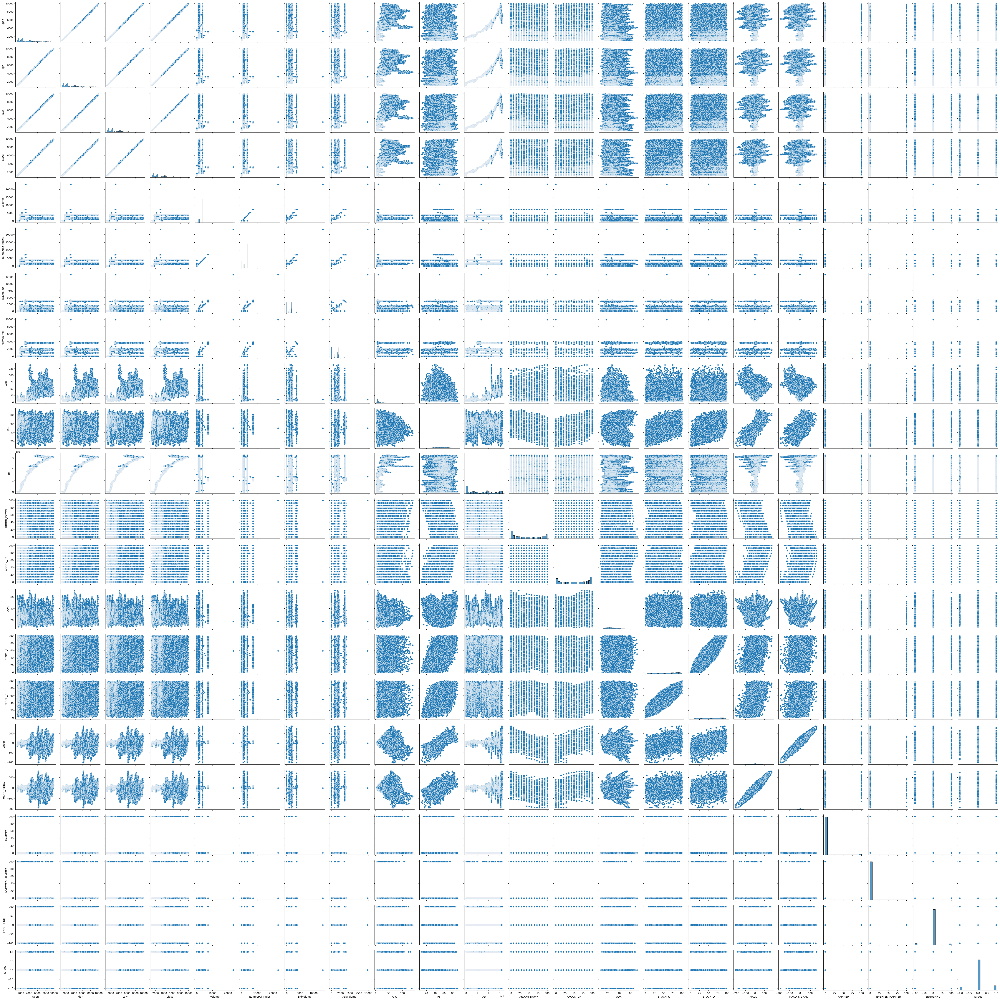

In [20]:
sns.pairplot(df)

ASk/Bid/Volume and no of trades line chart with date

In [20]:
d1 = df[['Volume', 'NumberOfTrades', 'BidVolume', 'AskVolume']]
d1.set_index(pd.to_datetime(df['Date']+df['Time']), inplace=True)


UCT 0 for Sierra chart

Sydney Session  : 21:00 - 06:00

Tokkyo Session  : 00:00 - 09:00

London Session  : 07:00 - 16:00

NewYork Session : 12:00 - 21:00

Which session have big Volume?

In [21]:
# market_session = {''}
import numpy as np
d1[['Sydney','Tokyo','London','NewYork']] = 0
d1['Sydney'] = np.where(((d1.index.hour >= 21) & (d1.index.hour < 24)) | (d1.index.hour<6),1,0)
d1['Tokyo'] = np.where((d1.index.hour >= 0) & (d1.index.hour<9),1,0)
d1['London'] = np.where((d1.index.hour >= 7) & (d1.index.hour<16),1,0)
d1['NewYork'] = np.where((d1.index.hour >= 12) & (d1.index.hour<21),1,0)
d1

c:\Users\PC\Documents\Python Projects\DRL\venv\lib\site-packages\pandas\core\frame.py:3645: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

c:\Users\PC\Documents\Python Projects\DRL\venv\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

c:\Users\PC\Documents\Python Projects\DRL\venv\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

,Volume,NumberOfTrades,BidVolume,AskVolume,Sydney,Tokyo,London,NewYork
2011-06-17 19:00:00,0,0,0,0,0,0,0,1
2011-06-17 20:00:00,0,0,0,0,0,0,0,1
2011-06-20 13:00:00,0,0,0,0,0,0,1,1
2011-06-20 14:00:00,0,0,0,0,0,0,1,1
2011-06-20 15:00:00,0,0,0,0,0,0,1,1
...,...,...,...,...,...,...,...,...
2022-12-16 18:00:00,3600,3600,1760,1840,0,0,0,1
2022-12-16 19:00:00,3600,3600,1783,1817,0,0,0,1
2022-12-16 20:00:00,3600,3600,1847,1753,0,0,0,1
2022-12-16 21:00:00,3600,3600,1,3599,1,0,0,0


In [22]:
d2 = {"Sydney"  : [d1['Volume'][d1['Sydney']==1].sum()],
      "Tokyo"   : [d1['Volume'][d1['Tokyo']==1].sum()],
      "London"  : [d1['Volume'][d1['London']==1].sum()],
      "NewYork" : [d1['Volume'][d1['NewYork']==1].sum()]}
d2=pd.DataFrame(d2)
d2 = d2.T
d2.columns = ['volumes' ]
d2['percent'] = 100 * (d2["volumes"] / d2["volumes"].sum())
# sns.barplot(x=d2.index, y=d2["price"])
d2

,volumes,percent
Sydney,3374650,4.264674
Tokyo,952,0.001203
London,17802302,22.497448
NewYork,57952412,73.236675


In [23]:
d2 = {"Sydney"  : [d1['NumberOfTrades'][d1['Sydney']==1].sum()],
      "Tokyo"   : [d1['NumberOfTrades'][d1['Tokyo']==1].sum()],
      "London"  : [d1['NumberOfTrades'][d1['London']==1].sum()],
      "NewYork" : [d1['NumberOfTrades'][d1['NewYork']==1].sum()]}
d2=pd.DataFrame(d2)
d2 = d2.T
d2.columns = ['volumes' ]
d2

,volumes
Sydney,3417850
Tokyo,952
London,18215612
NewYork,59183882


In [24]:
px.pie(names=d2.index, values=d2['volumes'] )

In [25]:
d1['Volume'][(d1['London']==1) & (d1['NewYork']==1)].sum()/d1['Volume'].sum()
d1['Volume'][(d1['Sydney']==1) & (d1['Tokyo']==1)].sum()/d1['Volume'].sum()

1.5523326390558217e-05

In [26]:
d1['year'] = d1.index.year
y_df=d1.groupby(['year'])['Volume'].sum().reset_index()
px.bar(x=y_df['year'],y=y_df['Volume'])

c:\Users\PC\Documents\Python Projects\DRL\venv\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [27]:
# y_df=d1[d1['Sydney']==1].groupby(['year'])['Volume'].sum().reset_index()
# fig = px.bar(x=y_df['year'],y=y_df['Volume'], title="Sydney Session")
# fig.update_layout(
#     autosize=False,
#     width=600,
#     height=300,)
# fig.show()
# y_df=d1[d1['Tokyo']==1].groupby(['year'])['Volume'].sum().reset_index()
# fig = px.bar(x=y_df['year'],y=y_df['Volume'], title="Tokyo Session")
# fig.update_layout(
#     autosize=False,
#     width=600,
#     height=300,)
# fig.show()
y_df=d1[d1['London']==1].groupby(['year'])['Volume'].sum().reset_index()
fig = px.bar(x=y_df['year'],y=y_df['Volume'], title="London Session")
fig.update_layout(
    autosize=False,
    width=600,
    height=300,)
fig.show()
y_df=d1[d1['NewYork']==1].groupby(['year'])['Volume'].sum().reset_index()
fig = px.bar(x=y_df['year'],y=y_df['Volume'], title="NewYork Session")
fig.update_layout(
    autosize=False,
    width=600,
    height=300,)
fig.show()

month wise volumes

In [28]:
d1['month'] = d1.index.month_name()
months = ["January", "February", "March", "April", "May", "June", 
          "July", "August", "September", "October", "November", "December"]
d1['month'] = pd.Categorical(d1['month'], categories=months, ordered=True)

d1.sort_values(by="month", inplace=True)

c:\Users\PC\Documents\Python Projects\DRL\venv\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

c:\Users\PC\Documents\Python Projects\DRL\venv\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

c:\Users\PC\Documents\Python Projects\DRL\venv\lib\site-packages\pandas\util\_decorators.py:311: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pand

In [29]:
y_df=d1.groupby(['month'])['Volume'].sum().reset_index()
fig = px.bar(x=y_df['month'],y=y_df['Volume'], title="Whole Session")
fig.update_layout(
    autosize=False,
    width=600,
    height=300,)
fig.show()
y_df=d1[d1['Sydney']==1].groupby(['month'])['Volume'].sum().reset_index()
fig = px.bar(x=y_df['month'],y=y_df['Volume'], title="Sydney Session")
fig.update_layout(
    autosize=False,
    width=600,
    height=300,)
fig.show()
y_df=d1[d1['Tokyo']==1].groupby(['month'])['Volume'].sum().reset_index()
fig = px.bar(x=y_df['month'],y=y_df['Volume'], title="Tokyo Session")
fig.update_layout(
    autosize=False,
    width=600,
    height=300,)
fig.show()
y_df=d1[d1['London']==1].groupby(['month'])['Volume'].sum().reset_index()
fig = px.bar(x=y_df['month'],y=y_df['Volume'], title="London Session")
fig.update_layout(
    autosize=False,
    width=600,
    height=300,)
fig.show()
y_df=d1[d1['NewYork']==1].groupby(['month'])['Volume'].sum().reset_index()
fig = px.bar(x=y_df['month'],y=y_df['Volume'], title="NewYork Session")
fig.update_layout(
    autosize=False,
    width=600,
    height=300,)
fig.show()

In [30]:
y_df=d1.groupby(['month'])['AskVolume'].sum().reset_index()
fig = px.bar(x=y_df['month'],y=y_df['AskVolume'], title="Whole Session")
fig.update_layout(
    autosize=False,
    width=600,
    height=300,)

Save Preprocess File

In [32]:
df.to_csv('../Dataset/process data/nasdaq_dataset.csv', index=False)